In [1]:
import sys

sys.path.append("c:\\Users\\robin\\Documents\\HyperBrain")
sys.path.append("c:\\Users\\robin\\Documents\\HyperBrain\\source")

In [4]:
from source.data_processing.cropping import crop_image
from source.visualization.image_visualization import plot_image_with_crop
from source.data_processing.image_reading import read_image
from torchvision.transforms import ToTensor
import torch

In [6]:
image_1.shape

torch.Size([1, 3827, 3284])

In [15]:
torch.arange(0, 3827-640, 320)

tensor([   0,  320,  640,  960, 1280, 1600, 1920, 2240, 2560, 2880])

The following code block just matches image 429 with 430. Do the same for 430-431, 431-432...

torch.Size([1, 3827, 3284]) torch.Size([1, 3827, 3284])


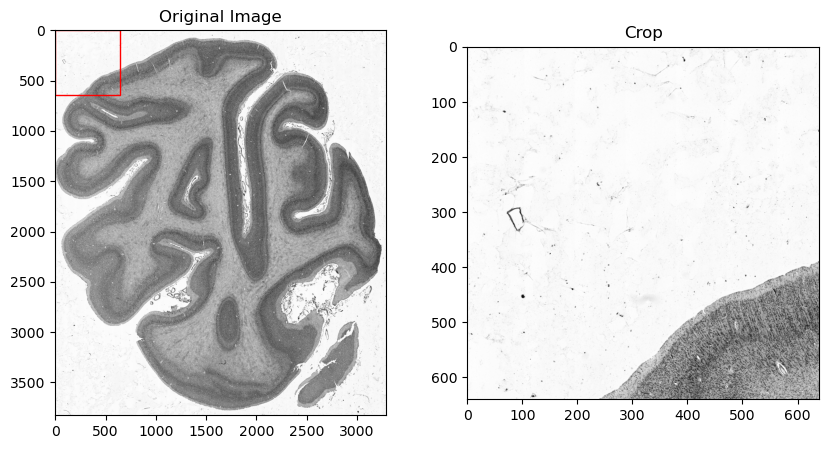

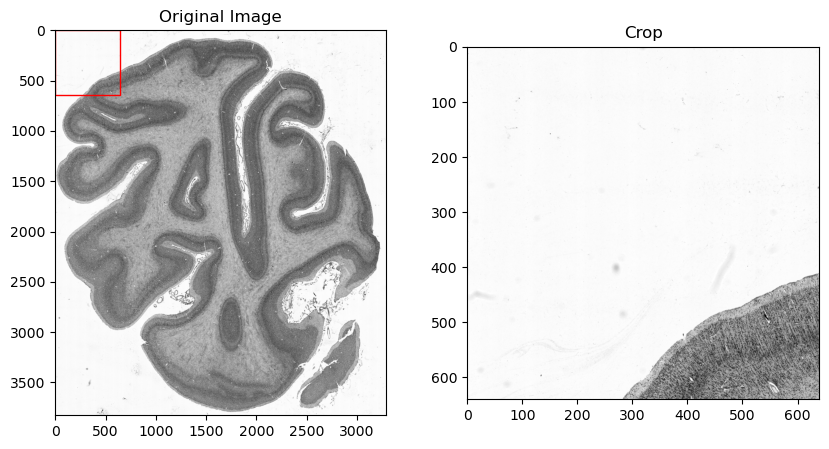

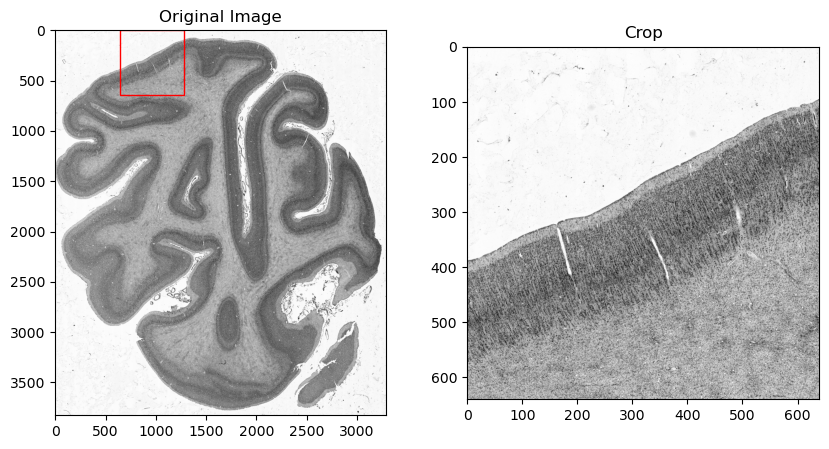

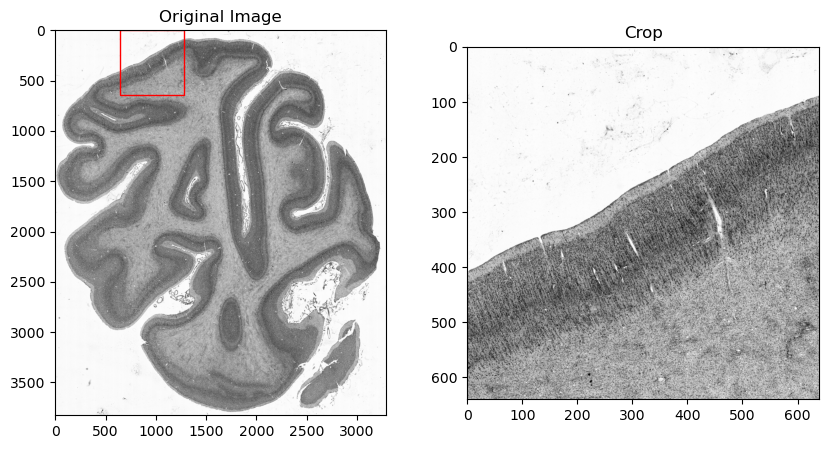

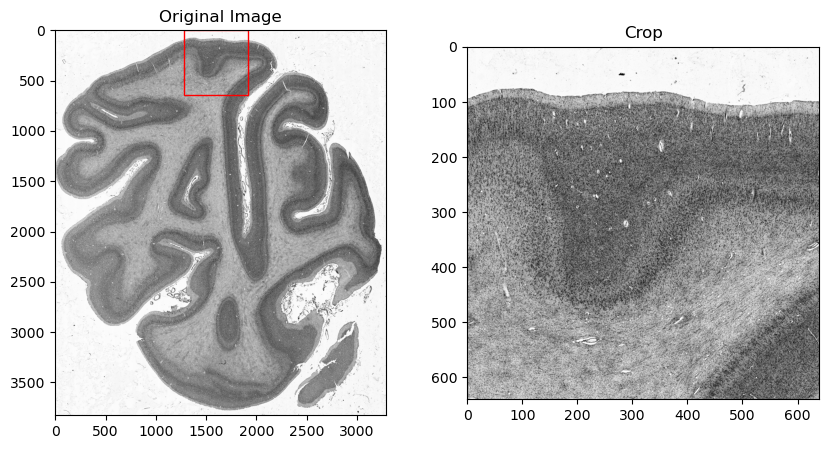

...

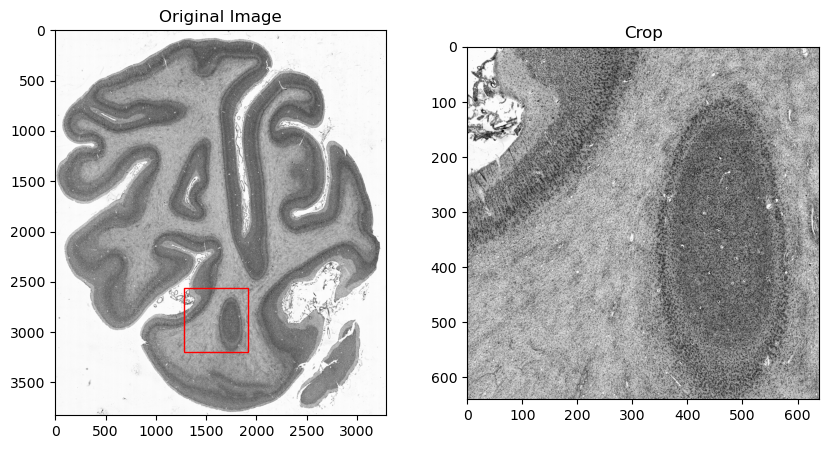

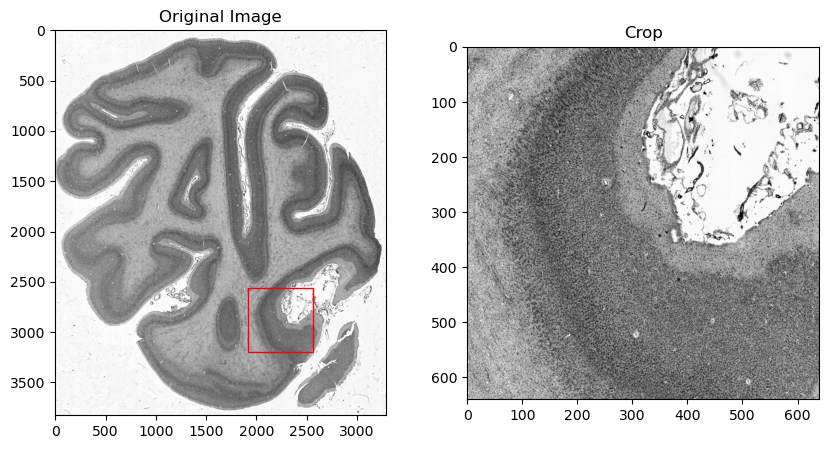

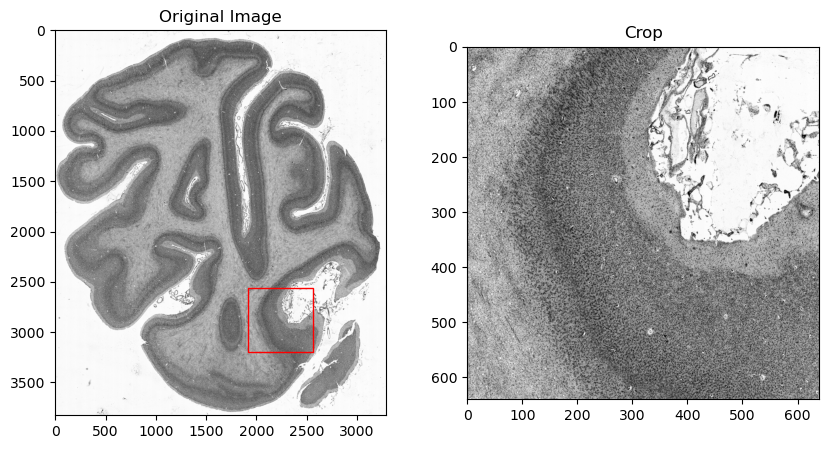

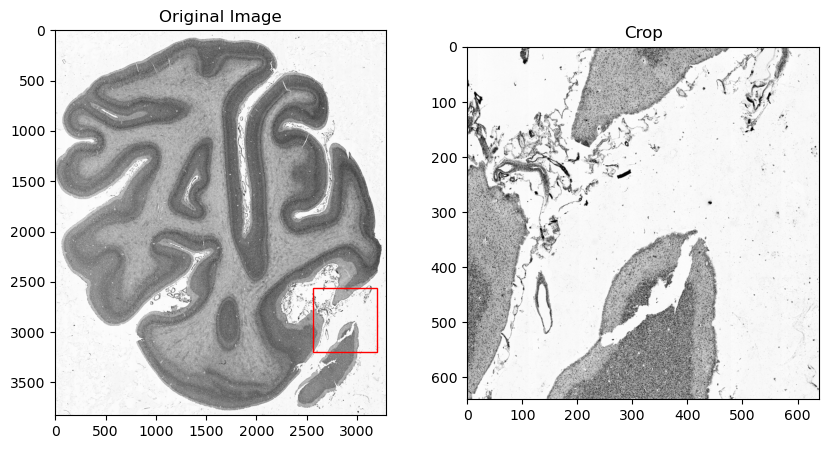

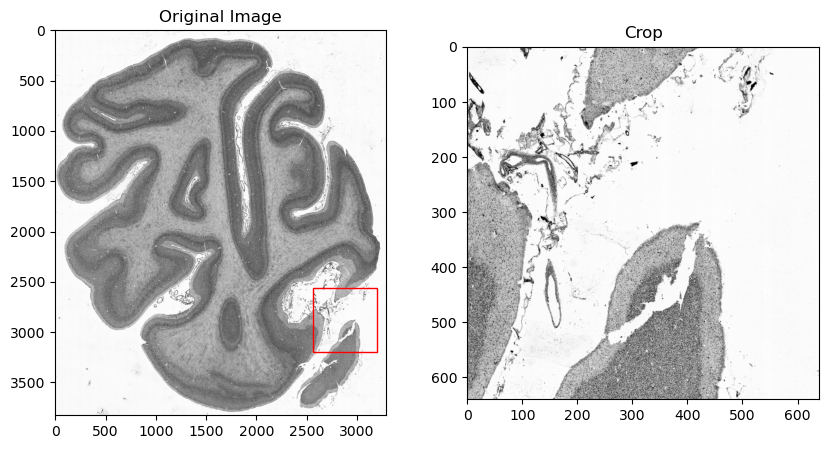

In [16]:
image_1 = read_image(r"C:\Users\robin\Documents\HyperBrain\data\cyto_original_downscaled_10x\B20_0429_Slice15.tif")
image_1 = ToTensor()(image_1)
image_1 = image_1[:, 3250:, :-28]

image_2 = read_image(r"C:\Users\robin\Documents\HyperBrain\data\cyto_original_downscaled_10x\B20_0430_Slice15.tif")
image_2 = ToTensor()(image_2)
image_2 = image_2[:, 3000:-293, :]

print(image_1.shape, image_2.shape)

crop_size = 640

for y in torch.arange(0, 3827-crop_size, crop_size//2):
    for x in torch.arange(0, 3827-crop_size, crop_size//2):
        crop_1 = crop_image(image_1, (x, y), crop_size)
        crop_2 = crop_image(image_2, (x, y), crop_size)

        ###########################
        # let loftr predict points between crops
        # add x and y to these so to translate them from crop to image scale
        # save points in global keypoint tensor idk
        ###########################

        plot_image_with_crop(image_1, crop_1, (x, y))
        plot_image_with_crop(image_2, crop_2, (x, y))
# crop_1 = crop_image(image_1, crop_position, crop_size)
# crop_2 = crop_image(image_2, crop_position, crop_size)

# plot_image_with_crop(image_1, crop_1, crop_position)
# plot_image_with_crop(image_2, crop_2, crop_position)

The tensor __matches__ should be of shape (M, 4) where the 4 columns indicating the x,y coordinates of image 1 and 2

In [19]:
# create matches

In [35]:
def compute_distance_vectorized(predicted_matches: torch.Tensor, coordinate_mapping: torch.Tensor) -> torch.Tensor:
    """
    Computes the Euclidean distance between predicted matches and the corresponding ground truth in a vectorized manner.

    Args:
        predicted_matches (torch.Tensor): A tensor of shape (M, 4) containing predicted matches.
                                           Each row is [i, j, k, l], where (i, j) are coordinates in image 1,
                                           and (k, l) are the predicted matching coordinates in image 2.
        coordinate_mapping (torch.Tensor): A 3D tensor of shape (H, W, 2) where each entry [i, j] contains
                                           the ground truth (x, y) coordinates in image 2 for the pixel (i, j)
                                           in image 1.

    Returns:
        torch.Tensor: A tensor of shape (M,) containing the Euclidean distances for each predicted match.
    """
    # Extract (i, j) indices from the predicted matches
    predicted_coordinates_image_1 = predicted_matches[:, :2].long()

    # Use advanced indexing to get the ground truth coordinates for each (i, j)
    ground_truth_coordinates = coordinate_mapping[predicted_coordinates_image_1[:, 1], predicted_coordinates_image_1[:, 0]]

    # Extract the predicted (k, l) coordinates
    predicted_coordinates_image_2 = predicted_matches[:, 2:]

    # Compute the Euclidean distances
    distances = torch.norm(ground_truth_coordinates - predicted_coordinates_image_2, dim=1)

    return distances

In [36]:
from source.data_processing.keypoints import generate_image_grid_coordinates

In [39]:
keypoints = generate_image_grid_coordinates((640,640))
predicted_matches = torch.Tensor([[0,0,10,0], [43,123, 44, 124], [245, 542, 250, 540]])

In [45]:
match_precision = {}
for pixel_threshold in torch.arange(0, 30, 0.1):
    match_precision[pixel_threshold] = (compute_distance_vectorized(predicted_matches, keypoints)<=pixel_threshold).float().mean()

In [46]:
match_precision

{tensor(0.): tensor(0.),
 tensor(0.1000): tensor(0.),
 tensor(0.2000): tensor(0.),
 tensor(0.3000): tensor(0.),
 tensor(0.4000): tensor(0.),
 tensor(0.5000): tensor(0.),
 tensor(0.6000): tensor(0.),
 tensor(0.7000): tensor(0.),
 tensor(0.8000): tensor(0.),
 tensor(0.9000): tensor(0.),
 tensor(1.): tensor(0.),
 tensor(1.1000): tensor(0.),
 tensor(1.2000): tensor(0.),
 tensor(1.3000): tensor(0.),
 tensor(1.4000): tensor(0.),
 tensor(1.5000): tensor(0.3333),
 tensor(1.6000): tensor(0.3333),
 tensor(1.7000): tensor(0.3333),
 tensor(1.8000): tensor(0.3333),
 tensor(1.9000): tensor(0.3333),
 tensor(2.): tensor(0.3333),
 tensor(2.1000): tensor(0.3333),
 tensor(2.2000): tensor(0.3333),
 tensor(2.3000): tensor(0.3333),
 tensor(2.4000): tensor(0.3333),
 tensor(2.5000): tensor(0.3333),
 tensor(2.6000): tensor(0.3333),
 tensor(2.7000): tensor(0.3333),
 tensor(2.8000): tensor(0.3333),
 tensor(2.9000): tensor(0.3333),
 tensor(3.): tensor(0.3333),
 tensor(3.1000): tensor(0.3333),
 tensor(3.2000): ten